# Generating object masks from input prompts with SAM 2

[![image](https://studiolab.sagemaker.aws/studiolab.svg)](https://studiolab.sagemaker.aws/import/github/opengeos/segment-geospatial/blob/main/docs/examples/sam2_predictor.ipynb)
[![image](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/opengeos/segment-geospatial/blob/main/docs/examples/sam2_predictor.ipynb)

This notebook shows how to generate object masks from input prompts with the Segment Anything Model 2 (SAM 2).

Make sure you use GPU runtime for this notebook. For Google Colab, go to `Runtime` -> `Change runtime type` and select `GPU` as the hardware accelerator.

## Install dependencies

Uncomment and run the following cell to install the required dependencies.

In [1]:
%pip install -U segment-geospatial

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.6/56.6 kB 2.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 152.8/152.8 kB 6.2 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 4.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.8/87.8 kB 8.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.3/17.3 MB 106.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 515.7/515.7 kB 42.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 568.1/568.1 kB 33.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 109.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.5/86.5 kB 8.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 22.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━

In [2]:
!pip install Pillow matplotlib

Please upload your TIFF image:
Saved /content/split_parts/BJ3N3_PSH_20240123062336_L4_2024A2_SC_018_RGB_sample_part11.tif with size (4375, 2705)
Saved /content/split_parts/BJ3N3_PSH_20240123062336_L4_2024A2_SC_018_RGB_sample_part12.tif with size (4375, 2705)
Saved /content/split_parts/BJ3N3_PSH_20240123062336_L4_2024A2_SC_018_RGB_sample_part21.tif with size (4375, 2705)
Saved /content/split_parts/BJ3N3_PSH_20240123062336_L4_2024A2_SC_018_RGB_sample_part22.tif with size (4375, 2705)


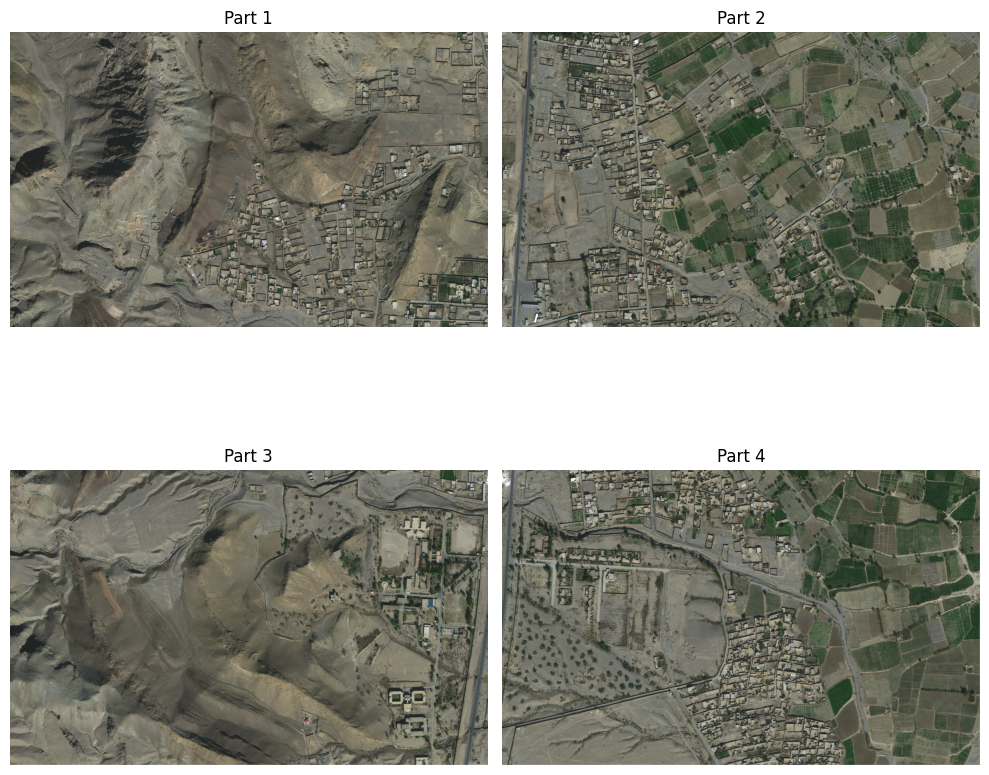

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [4]:
from PIL import Image
import os
from google.colab import files
import matplotlib.pyplot as plt

# Upload the image
print("Please upload your TIFF image:")
image_path =  "/content/BJ3N3_PSH_20240123062336_L4_2024A2_SC_018_RGB_sample.tif"
def split_image(image_path, output_dir):
    # Open the image
    img = Image.open(image_path)
    width, height = img.size

    # Calculate the target dimensions for each part (largest possible equal size)
    part_width = (width + 1) // 2  # Ceiling division to ensure equal parts
    part_height = (height + 1) // 2

    # Create a new blank image with padding if needed
    padded_width = part_width * 2
    padded_height = part_height * 2
    padded_img = Image.new('RGB', (padded_width, padded_height), (255, 255, 255))
    padded_img.paste(img, (0, 0))

    # Create output directory if it doesn't exist
    os.makedirs(output_dir, exist_ok=True)

    # Split into 4 parts and store for display
    parts = []
    for i in range(2):
        for j in range(2):
            # Calculate the crop box
            left = j * part_width
            upper = i * part_height
            right = left + part_width
            lower = upper + part_height

            # Crop the image
            part = padded_img.crop((left, upper, right, lower))
            parts.append(part)

            # Save the part
            output_filename = os.path.join(
                output_dir,
                f"{os.path.splitext(os.path.basename(image_path))[0]}_part{i+1}{j+1}.tif"
            )
            part.save(output_filename, format='TIFF')
            print(f"Saved {output_filename} with size {part.size}")

    # Display the parts
    fig, axes = plt.subplots(2, 2, figsize=(10, 10))
    for i, (part, ax) in enumerate(zip(parts, axes.ravel())):
        ax.imshow(part)
        ax.set_title(f"Part {i+1}")
        ax.axis('off')
    plt.tight_layout()
    plt.show()

    # Download the output files
    for i in range(2):
        for j in range(2):
            output_filename = os.path.join(
                output_dir,
                f"{os.path.splitext(os.path.basename(image_path))[0]}_part{i+1}{j+1}.tif"
            )
            files.download(output_filename)

# Run the function
output_dir = "/content/split_parts"
split_image(image_path, output_dir)

Please upload your GeoTIFF image:
Original image dimensions: 8749x5409 pixels
Each part will have square dimensions: 4375x4375 pixels
Padded image dimensions: 8750x8750 pixels
Saved /content/split_parts/BJ3N3_PSH_20240123062336_L4_2024A2_SC_018_RGB_sample_part11.tif with dimensions: 4375x4375 pixels
Saved /content/split_parts/BJ3N3_PSH_20240123062336_L4_2024A2_SC_018_RGB_sample_part12.tif with dimensions: 4375x4375 pixels
Saved /content/split_parts/BJ3N3_PSH_20240123062336_L4_2024A2_SC_018_RGB_sample_part21.tif with dimensions: 4375x4375 pixels
Saved /content/split_parts/BJ3N3_PSH_20240123062336_L4_2024A2_SC_018_RGB_sample_part22.tif with dimensions: 4375x4375 pixels


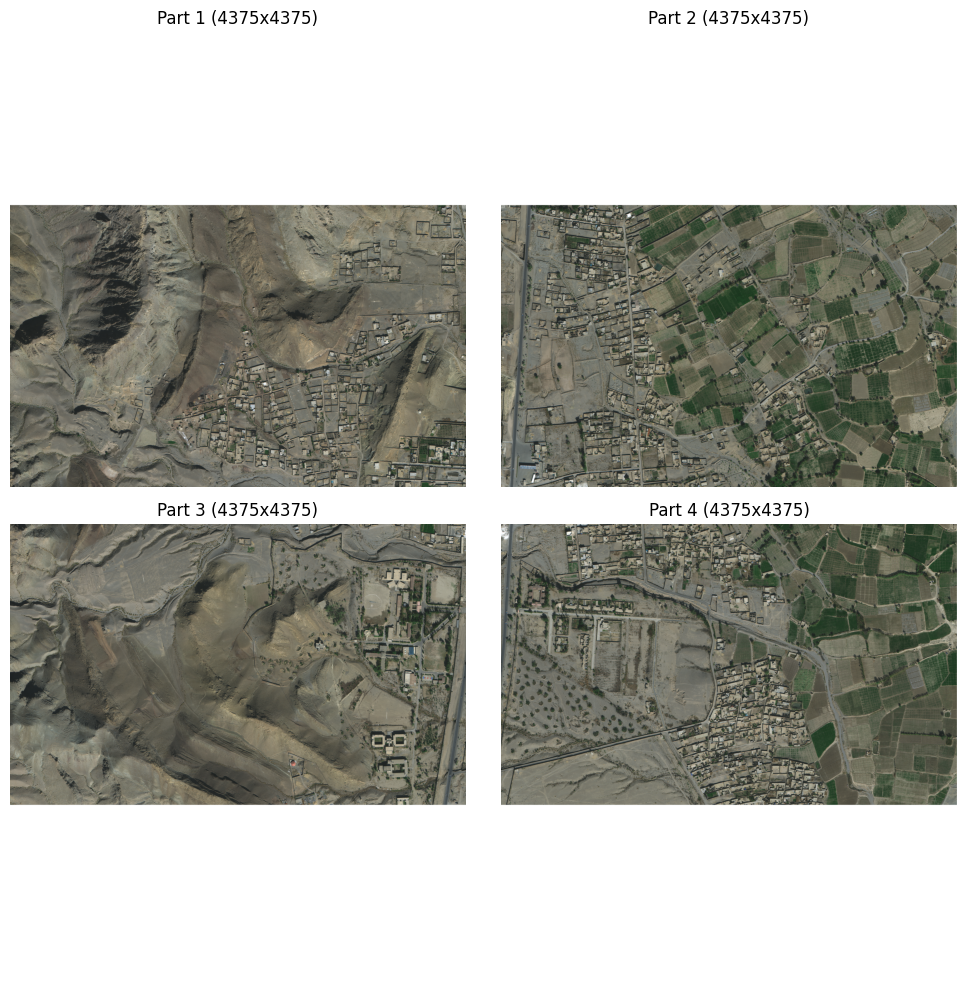

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [7]:
!pip install rasterio

import rasterio
from rasterio.windows import Window
import os
from google.colab import files
import matplotlib.pyplot as plt
import numpy as np

# Upload the image
print("Please upload your GeoTIFF image:")
image_path = "/content/BJ3N3_PSH_20240123062336_L4_2024A2_SC_018_RGB_sample.tif"

def split_geotiff_square(image_path, output_dir):
    # Open the image with rasterio
    with rasterio.open(image_path) as src:
        width, height = src.width, src.height
        profile = src.profile  # Get metadata profile
        print(f"Original image dimensions: {width}x{height} pixels")

        # Determine the size for the square image (smallest multiple of 2 >= max dimension)
        max_dim = max(width, height)
        square_dim = ((max_dim + 1) // 2) * 2  # Ceiling to next multiple of 2
        part_dim = square_dim // 2  # Each part will be square (part_dim x part_dim)
        print(f"Each part will have square dimensions: {part_dim}x{part_dim} pixels")

        # Create a padded array
        padded_data = np.full((src.count, square_dim, square_dim), 255, dtype=src.dtypes[0])
        data = src.read()  # Read all bands
        paste_x = (square_dim - width) // 2
        paste_y = (square_dim - height) // 2
        padded_data[:, paste_y:paste_y+height, paste_x:paste_x+width] = data
        print(f"Padded image dimensions: {square_dim}x{square_dim} pixels")

        # Update the geotransform for the padded image
        transform = src.transform
        new_transform = transform * rasterio.transform.Affine.translation(-paste_x, -paste_y)

        # Update the profile for the padded image
        profile.update(
            width=square_dim,
            height=square_dim,
            transform=new_transform
        )

        # Create output directory
        os.makedirs(output_dir, exist_ok=True)

        # Split into 4 square parts
        parts = []
        for i in range(2):
            for j in range(2):
                # Define the window for cropping
                left = j * part_dim
                upper = i * part_dim
                window = Window(left, upper, part_dim, part_dim)

                # Read the window from padded data
                part_data = padded_data[:, upper:upper+part_dim, left:left+part_dim]

                # Update the geotransform for this part
                part_transform = new_transform * rasterio.transform.Affine.translation(left, upper)

                # Create a new profile for the part
                part_profile = profile.copy()
                part_profile.update(
                    width=part_dim,
                    height=part_dim,
                    transform=part_transform
                )

                # Save the part
                output_filename = os.path.join(
                    output_dir,
                    f"{os.path.splitext(os.path.basename(image_path))[0]}_part{i+1}{j+1}.tif"
                )
                with rasterio.open(output_filename, 'w', **part_profile) as dst:
                    dst.write(part_data)
                print(f"Saved {output_filename} with dimensions: {part_dim}x{part_dim} pixels")

                # Store part for display (convert to RGB for visualization)
                if src.count >= 3:
                    part_rgb = part_data[:3].transpose(1, 2, 0)  # First 3 bands
                else:
                    part_rgb = part_data[0]  # Single band
                parts.append(part_rgb)

        # Display the parts
        fig, axes = plt.subplots(2, 2, figsize=(10, 10))
        for i, (part, ax) in enumerate(zip(parts, axes.ravel())):
            ax.imshow(part if src.count == 1 else part[:, :, :3])
            ax.set_title(f"Part {i+1} ({part_dim}x{part_dim})")
            ax.axis('off')
        plt.tight_layout()
        plt.show()

        # Download the output files
        for i in range(2):
            for j in range(2):
                output_filename = os.path.join(
                    output_dir,
                    f"{os.path.splitext(os.path.basename(image_path))[0]}_part{i+1}{j+1}.tif"
                )
                files.download(output_filename)

# Run the function
output_dir = "/content/split_parts"
split_geotiff_square(image_path, output_dir)

In [8]:
import leafmap
from samgeo import SamGeo2

## Create an interactive map

In [9]:
m = leafmap.Map(center=[27.851072,66.602218], zoom=15)
m.add_basemap("SATELLITE")
m

Map(center=[27.851072, 66.602218], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title',…

## Download a sample image

Pan and zoom the map to select the area of interest. Use the draw tools to draw a polygon or rectangle on the map

In [ ]:
if m.user_roi is not None:
    bbox = m.user_roi_bounds()
else:
    bbox = [-122.1497, 37.6311, -122.1203, 37.6458]

In [ ]:
image = "satellite.tif"
leafmap.map_tiles_to_geotiff(
    output=image, bbox=bbox, zoom=16, source="Satellite", overwrite=True
)

You can also use your own image. Uncomment and run the following cell to use your own image.

In [12]:
image = '/content/split_parts/BJ3N3_PSH_20240123062336_L4_2024A2_SC_018_RGB_sample_part12.tif'

Display the downloaded image on the map.

In [13]:
m.layers[-1].visible = False
m.add_raster(image, layer_name="Image")
m

Map(bottom=7036583.0, center=[27.854063500000002, 66.60230899999999], controls=(ZoomControl(options=['position…

## Initialize SAM class

Set `automatic=False` to use the predictor mode rather than the automatic mode.

In [14]:
sam2 = SamGeo2(
    model_id="sam2-hiera-large",
    automatic=False,
)

sam2_hiera_large.pt:   0%|          | 0.00/898M [00:00<?, ?B/s]

Specify the image to segment.

In [15]:
sam2.set_image(image)

## Image segmentation with input points

A single point can be used to segment an object. The point can be specified as a tuple of (x, y), such as (col, row) or (lon, lat). The points can also be specified as a file path to a vector dataset. For non (col, row) input points, specify the `point_crs` parameter, which will automatically transform the points to the image column and row coordinates.

Try a single point input:

In [ ]:
point_coords = [[-122.1419, 37.6383]]
sam2.predict(point_coords, point_labels=1, point_crs="EPSG:4326", output="mask1.tif")
m.add_raster("mask1.tif", layer_name="Mask1", nodata=0, cmap="Blues", opacity=1)
m

Try multiple points input:

In [ ]:
point_coords = [[-122.1464, 37.6431], [-122.1449, 37.6415], [-122.1451, 37.6395]]
sam2.predict(point_coords, point_labels=1, point_crs="EPSG:4326", output="mask2.tif")
m.add_raster("mask2.tif", layer_name="Mask2", nodata=0, cmap="Greens", opacity=1)
m

## Interactive segmentation

Display the interactive map and use the marker tool to draw points on the map. Then click on the `Segment` button to segment the objects. The results will be added to the map automatically. Click on the `Reset` button to clear the points and the results.

In [17]:
m = sam2.show_map()
m

Map(center=[27.854063500000002, 66.60230899999999], controls=(ZoomControl(options=['position', 'zoom_in_text',…

![](https://i.imgur.com/2Nyg9uW.gif)